# Data Assessment & Analytics
Notes:
- change os directory location
- be aware of the number of provdied native source data files

In [1]:
# working with data
import os
import numpy as np
import pandas as pd
import geopandas as gpd # the library that lets us read in shapefiles
import geoplot as gplt # for plotting maps
import geoplot.crs as gcrs #used to pull in webdata

# visulizaiton
import missingno as msno # creates a matrix chart to show missing values
import plotly.express as px
import plotly.graph_objects as go # for subplot creation
from plotly.subplots import make_subplots # for subplot creation
import matplotlib.pyplot as mplt # use with gplt to save fig to pdf

# Cleanup
from datetime import datetime
pd.set_option('display.max_columns', 999)  # How to display all columns of a Pandas DataFrame in Jupyter Notebook

In [2]:
# Set Working Directory
workingDir = "G:/Shared drives/WaDE Data/Nevada/WaterAllocation" # change here
os.chdir(workingDir)

In [3]:
# This needs to be custom per state

# Input Data
#################################################################
# Data 1: POD AllApps_2_input
df1 = pd.read_csv('RawinputData/POD AllApps_2_input.zip')

# Data 2: PoU AllApps_3_input
df2 = pd.read_csv('RawinputData/PoU AllApps_3_input.zip')

C:\Users\rjame\AppData\Local\Temp\ipykernel_20896\3477272776.py:6: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df1 = pd.read_csv('RawinputData/POD AllApps_2_input.zip')


In [4]:
# Input Data - Processed WaDE Input files
#################################################################
dfws = pd.read_csv("ProcessedInputData/watersources.csv").replace(np.nan, "")
dfwspurge = pd.read_csv("ProcessedInputData/watersources_missing.csv").replace(np.nan, "")

dfs = pd.read_csv("ProcessedInputData/sites.csv").replace(np.nan, "")
dfspurge = pd.read_csv("ProcessedInputData/sites_missing.csv").replace(np.nan, "")

dfaa = pd.read_csv("ProcessedInputData/waterallocations.csv").replace(np.nan, "")
dfaapurge = pd.read_csv("ProcessedInputData/waterallocations_missing.csv").replace(np.nan, "")

C:\Users\rjame\AppData\Local\Temp\ipykernel_20896\367920039.py:6: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  dfs = pd.read_csv("ProcessedInputData/sites.csv").replace(np.nan, "")


# Water Source Info
- watersources.csv

In [5]:
print(len(dfws))
dfws.head(1)

6


,WaterSourceUUID,Geometry,GNISFeatureNameCV,WaterQualityIndicatorCV,WaterSourceName,WaterSourceNativeID,WaterSourceTypeCV
0,NVwr_WSwadeID1,,,Fresh,WaDE Unspecified,wadeID1,Surface Water


<AxesSubplot: >

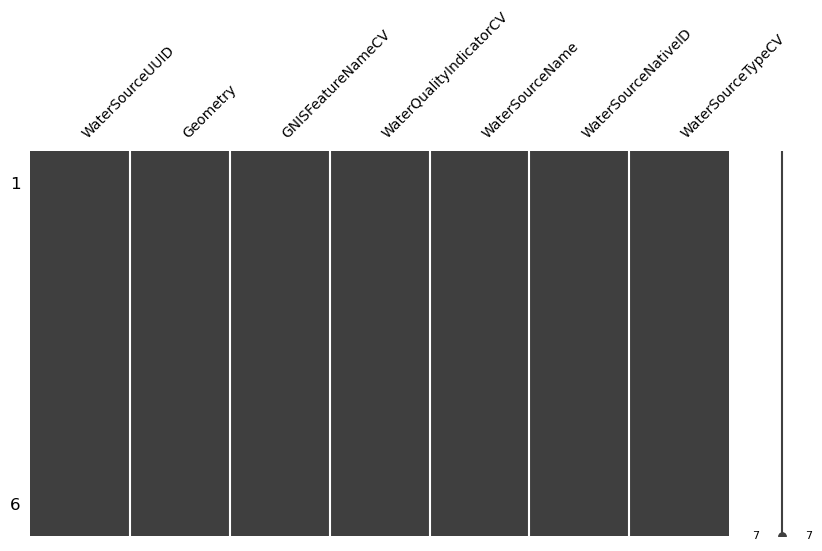

In [6]:
# Check what columns contain missing information.
msno.matrix(dfws, figsize=(10,5), fontsize=10)

In [7]:
# Unique values for 'WaterSourceTypeCV'
for x in dfws['WaterSourceTypeCV'].sort_values().unique():
    print(f'"' + x + '",')

"Groundwater",
"Reservoir",
"Reuse",
"Storage",
"Surface Water",
"Unknown",


In [8]:
# WaterSourceTypeCV: histogram distribution of WaDE values
print(dfws.WaterSourceTypeCV.value_counts())

fig = px.histogram(dfws, x="WaterSourceTypeCV")
fig.update_layout(bargap=0.2,
                  title="Histogram of WaterSourceTypeCV Entries in watersource.csv",
                  xaxis_title="WaterSourceTypeCV Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/WaterSourceTypeCV.pdf', engine="kaleido")

Surface Water    1
Groundwater      1
Reservoir        1
Storage          1
Reuse            1
Unknown          1
Name: WaterSourceTypeCV, dtype: int64


# Site Info
- sites.csv

In [9]:
print(len(dfs))
dfs.head(1)

128955


,SiteUUID,RegulatoryOverlayUUIDs,WaterSourceUUIDs,CoordinateAccuracy,CoordinateMethodCV,County,EPSGCodeCV,Geometry,GNISCodeCV,HUC12,HUC8,Latitude,Longitude,NHDNetworkStatusCV,NHDProductCV,PODorPOUSite,SiteName,SiteNativeID,SitePoint,SiteTypeCV,StateCV,USGSSiteID
0,NVwr_SPOD0,,NVwr_WSwadeID1,WaDE Unspecified,Digitized,Humboldt,4326,,,,,41.988335,-118.527229,,,POD,WaDE Unspecified,POD0,,stream,NV,


<AxesSubplot: >

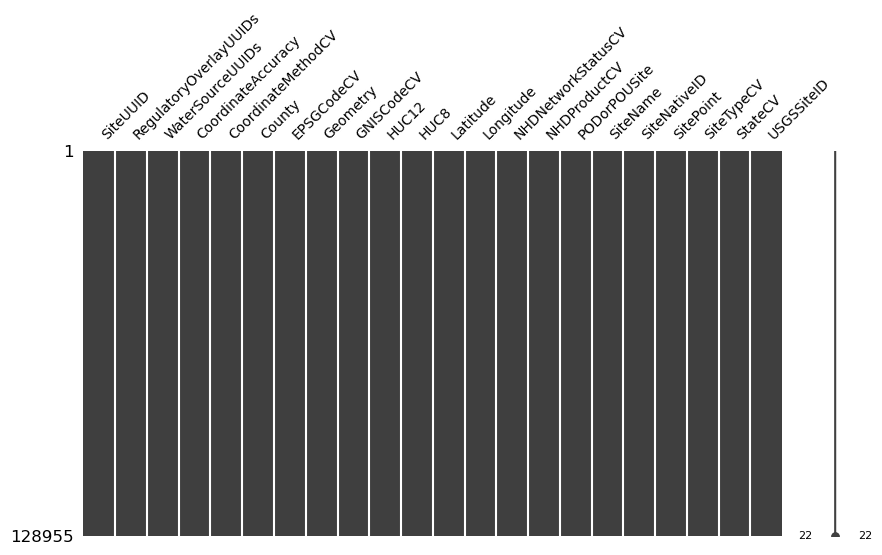

In [10]:
# Check what columns contain missing information.
msno.matrix(dfs, figsize=(10,5), fontsize=10)

In [11]:
# Unique values for 'CoordinateMethodCV'
for x in dfs['CoordinateMethodCV'].sort_values().unique():
    print(f'"' + x + '",')

"Digitized",


In [12]:
# Unique values for 'SiteTypeCV'
for x in dfs['SiteTypeCV'].sort_values().unique():
    print(f'"' + x + '",')

"Effluent",
"Geothermal",
"Other Ground Water",
"Other Surface Water",
"Reservoir",
"Spring",
"Storage",
"Underground",
"Unknown",
"lake",
"stream",


In [13]:
# SiteTypeCV: histogram distribution of WaDE values
print(dfs.SiteTypeCV.value_counts())

fig = px.histogram(dfs, x="SiteTypeCV")
fig.update_layout(bargap=0.2,
                  title="Histogram of SiteTypeCV Entries in sites.csv",
                  xaxis_title="SiteTypeCV Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/SiteTypeCV.pdf', engine="kaleido")

Underground            80242
stream                 23680
Spring                 20560
Other Surface Water     1021
lake                     906
Geothermal               903
Effluent                 527
Storage                  503
Other Ground Water       366
Reservoir                246
Unknown                    1
Name: SiteTypeCV, dtype: int64


In [14]:
# PODorPOUSite: histogram distribution of WaDE values
print(dfs.PODorPOUSite.value_counts())

fig = px.histogram(dfs, x="PODorPOUSite")
fig.update_layout(bargap=0.2,
                  title="Histogram of PODorPOUSite Entries in sites.csv",
                  xaxis_title="PODorPOUSite Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/PODorPOUSite.pdf', engine="kaleido")

POD    100579
POU     28376
Name: PODorPOUSite, dtype: int64


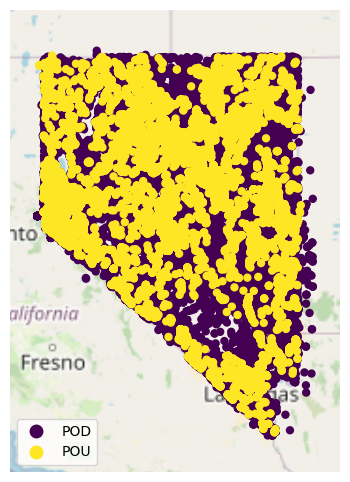

In [15]:
# map the site info (this would be lat & long Points only)
try:
    contiguous_usa = gpd.read_file(gplt.datasets.get_path('contiguous_usa')) # use for background map in subplot
    ax = gplt.webmap(contiguous_usa, projection=gcrs.WebMercator()) # set subplot
    
    dfsPoint = dfs.copy()
    gdfsPoint = gpd.GeoDataFrame(dfsPoint, geometry=gpd.points_from_xy(dfsPoint.Longitude.astype(float), dfsPoint.Latitude.astype(float)), crs="EPSG:4326")
    gplt.pointplot(gdfsPoint, hue='PODorPOUSite', legend=True, legend_var='hue', ax=ax)
    mplt.savefig(format="pdf", fname='DataAssessment/figures/PointMap.pdf')
    
except:
    print('No point data to plot')

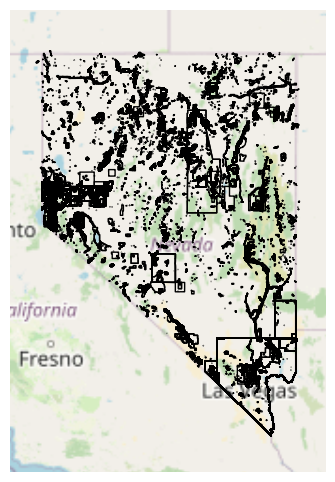

In [16]:
# Map poly info
try:
    contiguous_usa = gpd.read_file(gplt.datasets.get_path('contiguous_usa')) # use for background map in subplot
    ax = gplt.webmap(contiguous_usa, projection=gcrs.WebMercator()) # set subplot
    
    dfsPoly = dfs.copy()
    dfsPoly = dfsPoly[dfsPoly['Geometry'] != ""].reset_index(drop=True)
    dfsPoly['Geometry'] = gpd.GeoSeries.from_wkt(dfsPoly['Geometry'], crs="EPSG:4326")
    gdfsPoly = gpd.GeoDataFrame(dfsPoly, geometry=dfsPoly['Geometry'], crs="EPSG:4326") # covert to geodataframe
    gdfsPoly['Geometry'] = gdfsPoly.simplify(0.001) # simplify the geometry. Lower the number the larger the exported file.
    gplt.polyplot(gdfsPoly, ax=ax)
    mplt.savefig(format="pdf", fname='DataAssessment/figures/PolyMap.pdf')
except:
    print('No geometry data to plot')

In [17]:
dfsPoly.head()

,SiteUUID,RegulatoryOverlayUUIDs,WaterSourceUUIDs,CoordinateAccuracy,CoordinateMethodCV,County,EPSGCodeCV,Geometry,GNISCodeCV,HUC12,HUC8,Latitude,Longitude,NHDNetworkStatusCV,NHDProductCV,PODorPOUSite,SiteName,SiteNativeID,SitePoint,SiteTypeCV,StateCV,USGSSiteID,geometry
0,NVwr_SPOU0,,NVwr_WSwadeID2,WaDE Unspecified,Digitized,Elko,4326,"MULTIPOLYGON (((-116.12022 41.27816, -116.1152...",,,,41.276172,-116.117519,,,POU,036 N39 E52 15DBCC2,POU0,,Underground,NV,,"MULTIPOLYGON (((-116.12022 41.27816, -116.1152..."
1,NVwr_SPOU1,,NVwr_WSwadeID2,WaDE Unspecified,Digitized,Humboldt,4326,"POLYGON ((-117.80959 41.56965, -117.79038 41.5...",,,,41.567773,-117.799972,,,POU,033A N43 E37 34BBBD1,POU1,,Underground,NV,,"POLYGON ((-117.80959 41.56965, -117.80478 41.5..."
2,NVwr_SPOU10,,NVwr_WSwadeID2,WaDE Unspecified,Digitized,Washoe,4326,"POLYGON ((-119.84220 39.24305, -119.83383 39.2...",,,,39.239715,-119.838722,,,POU,089 N16 E19 22BDCC1,POU10,,Underground,NV,,"POLYGON ((-119.84220 39.24305, -119.84057 39.2..."
3,NVwr_SPOU100,,NVwr_WSwadeID1,WaDE Unspecified,Digitized,Churchill,4326,"MULTIPOLYGON (((-117.67284 39.79915, -117.6682...",,,,39.799131,-117.668199,,,POU,128 N22 E38 02DCDB1,POU100,,Spring,NV,,"MULTIPOLYGON (((-117.67284 39.79915, -117.6682..."
4,NVwr_SPOU1000,,NVwr_WSwadeID1,WaDE Unspecified,Digitized,Pershing,4326,"POLYGON ((-117.66673 40.26148, -117.66546 40.2...",,,,40.253631,-117.668530,,,POU,130 N28 E38 26DBAB1,POU1000,,stream,NV,,"POLYGON ((-117.66673 40.26148, -117.66672 40.2..."


# Allocation Amount Info
- waterallocations.csv

In [18]:
print(len(dfaa))
dfaa.head(1)

101438


,AllocationUUID,MethodUUID,OrganizationUUID,SiteUUID,VariableSpecificUUID,AllocationApplicationDate,AllocationAssociatedConsumptiveUseSiteIDs,AllocationAssociatedWithdrawalSiteIDs,AllocationBasisCV,AllocationChangeApplicationIndicator,AllocationCommunityWaterSupplySystem,AllocationCropDutyAmount,AllocationExpirationDate,AllocationFlow_CFS,AllocationLegalStatusCV,AllocationNativeID,AllocationOwner,AllocationPriorityDate,AllocationSDWISIdentifierCV,AllocationTimeframeEnd,AllocationTimeframeStart,AllocationTypeCV,AllocationVolume_AF,BeneficialUseCategory,CommunityWaterSupplySystem,CropTypeCV,CustomerTypeCV,DataPublicationDate,DataPublicationDOI,ExemptOfVolumeFlowPriority,GeneratedPowerCapacityMW,IrrigatedAcreage,IrrigationMethodCV,LegacyAllocationIDs,OwnerClassificationCV,PopulationServed,PowerType,PrimaryBeneficialUseCategory,WaterAllocationNativeURL
0,NVwr_WR1,NVwr_M1,NVwr_O1,NVwr_SPOD42384,NVwr_V1,,,,,,,,,0.0,Canceled,1,WaDE Unspecified,1905-05-12,,,,,0.0,Power,,,,04/19/2023,,0,,,,,WaDE Unspecified,,,Hydroelectric,http://water.nv.gov/permitinformation.aspx?app=1


In [19]:
# Unique values for 'AllocationBasisCV'
for x in dfaa['AllocationBasisCV'].sort_values().unique():
    print(f'"' + str(x) + '",')

"",


In [20]:
# Unique values for 'AllocationTypeCV'
for x in dfaa['AllocationTypeCV'].sort_values().unique():
    print(f'"' + x + '",')

"",


In [21]:
# Unique values for 'AllocationLegalStatusCV'
for x in dfaa['AllocationLegalStatusCV'].sort_values().unique():
    print(f'"' + x + '",')

"Abandoned",
"Abrogated",
"Application",
"Canceled",
"Certificate",
"Curtailed",
"Decreed",
"Denied",
"Expired",
"Forfeited",
"Permit",
"Ready For Action",
"Ready for Action (Protested)",
"Rejected",
"Relinquish a Portion",
"Relinquished",
"Rescinded",
"Reserved",
"Revocable Permit",
"Revoked",
"Supersceded",
"Suspended",
"Vested Rights",
"Withdrawn",


In [22]:
# Unique values for 'BeneficialUseCategory'
uniqueList = list(set([i.strip() for i in ','.join(dfaa['BeneficialUseCategory'].astype(str)).split(',')]))
uniqueList.sort()
uniqueList

['As Decreed',
 'Commercial',
 'Construction',
 'Dewatering',
 'Domestic',
 'Environmental',
 'Evaporation',
 'Industrial',
 'Irrigation',
 'Irrigation-Carey Act',
 'Irrigation-DLE',
 'Mining Milling and Dewatering',
 'Mining and Milling',
 'Municipal',
 'Other',
 'Power',
 'Quasi-Municipal',
 'Recreational',
 'Stockwatering',
 'Storage',
 'Unknown',
 'Wildlife']

In [23]:
# Unique values for 'OwnerClassificationCV'
for x in dfaa['OwnerClassificationCV'].sort_values().unique():
    print(f'"' + x + '",')

"Bureau of Indian Affairs (USBIA)",
"Bureau of Land Management (USBLM)",
"Fish and Wildlife Service (USFWS)",
"Military",
"Native American",
"United States of America",
"WaDE Unspecified",
"WaDE Unspecified ",


<AxesSubplot: >

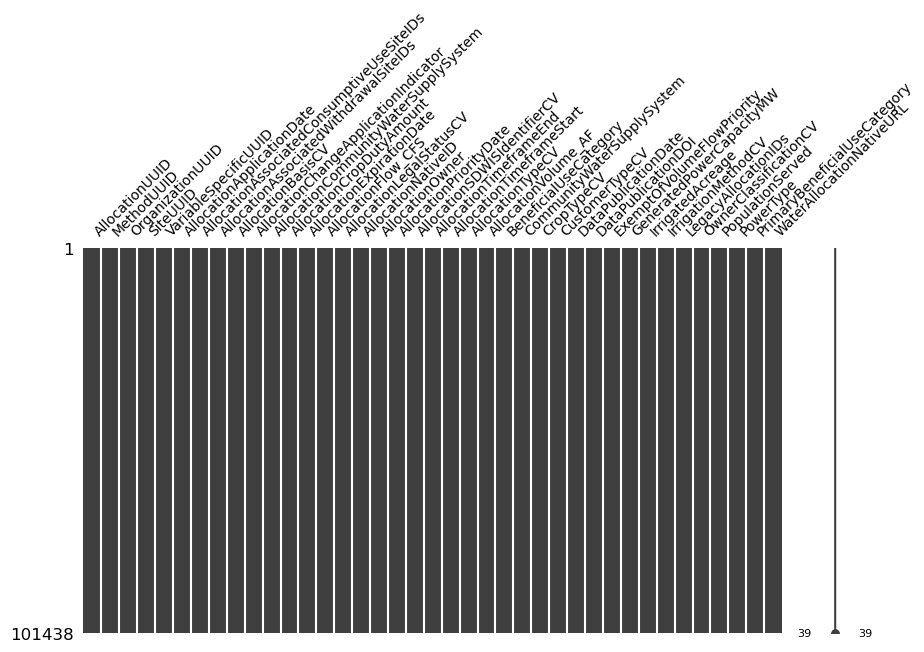

In [24]:
# Check what columns contain missing information.
msno.matrix(dfaa, figsize=(10,5), fontsize=10)

In [25]:
# AllocationFlow_CFS: Boxplot distribution of WaDE values
try:
    trace1 = go.Violin(x=dfaa['AllocationFlow_CFS'], points='outliers', name='Violin Plot')
    trace2 = go.Histogram(x=dfaa['AllocationFlow_CFS'], name='Historgram')

    fig = make_subplots(rows=2, cols=1)
    fig.add_trace(trace1, row=1, col=1)
    fig.add_trace(trace2, row=2, col=1)

    fig.update_layout(showlegend=False, bargap=0.2, title="AllocationFlow_CFS Distribution in waterallocations.csv", font=dict(family="Arial Bold", size=12,color="Black"))
    fig.update_xaxes(title_text="AllocationFlow_CFS Value", row=1, col=1)
    fig.update_xaxes(title_text="AllocationFlow_CFS Value", row=2, col=1)
    fig.update_yaxes(title_text="Num. of Records", row=2, col=1)
    fig.show()
    fig.write_image('DataAssessment/figures/AllocationFlow_CFS.pdf', engine="kaleido")

except: print('Could not plot AllocationFlow_CFS value.')

In [26]:
# AllocationVolume_AF: Boxplot distribution of WaDE values
try:
    trace1 = go.Violin(x=dfaa['AllocationVolume_AF'], points='outliers', name='Violin Plot')
    trace2 = go.Histogram(x=dfaa['AllocationVolume_AF'], name='Historgram')

    fig = make_subplots(rows=2, cols=1)
    fig.add_trace(trace1, row=1, col=1)
    fig.add_trace(trace2, row=2, col=1)

    fig.update_layout(showlegend=False, bargap=0.2, title="AllocationVolume_AF Distribution in waterallocations.csv", font=dict(family="Arial Bold", size=12,color="Black"))
    fig.update_xaxes(title_text="AllocationVolume_AF Value", row=1, col=1)
    fig.update_xaxes(title_text="AllocationVolume_AF Value", row=2, col=1)
    fig.update_yaxes(title_text="Num. of Records", row=2, col=1)
    fig.show()
    fig.write_image('DataAssessment/figures/AllocationVolume_AF.pdf', engine="kaleido")

except: print('Could not plot AllocationVolume_AF value.')

In [27]:
# AllocationLegalStatusCV: histogram distribution of WaDE values
print(dfaa.AllocationLegalStatusCV.value_counts())

fig = px.histogram(dfaa, x="AllocationLegalStatusCV")
fig.update_layout(bargap=0.2,
                  title="Histogram of AllocationLegalStatusCV Entries in waterallocations.csv",
                  xaxis_title="AllocationLegalStatusCV Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/AllocationLegalStatusCV.pdf', engine="kaleido")

Canceled                        18544
Certificate                     17531
Withdrawn                       12395
Denied                          11170
Abrogated                       10400
Permit                           8689
Vested Rights                    7347
Expired                          6923
Decreed                          1907
Reserved                         1469
Revocable Permit                  925
Ready For Action                  853
Relinquish a Portion              806
Ready for Action (Protested)      778
Forfeited                         724
Revoked                           354
Relinquished                      216
Rejected                          131
Supersceded                       112
Abandoned                         102
Application                        57
Suspended                           3
Rescinded                           1
Curtailed                           1
Name: AllocationLegalStatusCV, dtype: int64


In [28]:
# OwnerClassificationCV: histogram distribution of WaDE values
print(dfaa.OwnerClassificationCV.value_counts())

fig = px.histogram(dfaa, x="OwnerClassificationCV")
fig.update_layout(bargap=0.2,
                  title="Histogram of OwnerClassificationCV Entries in waterallocations.csv",
                  xaxis_title="OwnerClassificationCV Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/OwnerClassificationCV.pdf', engine="kaleido")

WaDE Unspecified                     50368
WaDE Unspecified                     48227
Bureau of Land Management (USBLM)     2003
Fish and Wildlife Service (USFWS)      366
Native American                        232
United States of America               197
Bureau of Indian Affairs (USBIA)        39
Military                                 6
Name: OwnerClassificationCV, dtype: int64


In [29]:
# PrimaryBeneficialUseCategory: histogram distribution of WaDE values
print(dfaa.PrimaryBeneficialUseCategory.value_counts())

fig = px.histogram(dfaa, x="PrimaryBeneficialUseCategory")
fig.update_layout(bargap=0.2,
                  title="Histogram of PrimaryBeneficialUseCategory Entries in waterallocations.csv",
                  xaxis_title="PrimaryBeneficialUseCategory Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/PrimaryBeneficialUseCategory.pdf', engine="kaleido")

Agriculture Irrigation    37015
Livestock                 17911
Public Supply             17003
Mining                    11151
Commercial/Industrial      6422
Unspecified                3404
Other                      2344
Domestic                   1768
Recreation                 1625
In-stream Flow             1199
Hydroelectric              1164
Reservoir Storage           432
Name: PrimaryBeneficialUseCategory, dtype: int64


In [30]:
# ExemptOfVolumeFlowPriority: histogram distribution of WaDE values
print(dfaa.ExemptOfVolumeFlowPriority.value_counts())

fig = px.histogram(dfaa, x="ExemptOfVolumeFlowPriority")
fig.update_layout(bargap=0.2,
                  title="Histogram of ExemptOfVolumeFlowPriority Entries in waterallocations.csv",
                  xaxis_title="ExemptOfVolumeFlowPriority Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/ExemptOfVolumeFlowPriority.pdf', engine="kaleido")

0    101438
Name: ExemptOfVolumeFlowPriority, dtype: int64


In [31]:
# AllocationPriorityDate: histogram distribution of WaDE values
print(dfaa.AllocationPriorityDate.value_counts())

dfaaCopy = dfaa.copy()
dfaaCopy = dfaaCopy[(dfaaCopy['ExemptOfVolumeFlowPriority'] < 1)]
dfaaCopy = dfaaCopy.reset_index(drop=True)
fig = px.histogram(dfaaCopy, x="AllocationPriorityDate")
fig.update_layout(bargap=0.2,
                  title="Histogram of AllocationPriorityDate Entries in waterallocations.csv",
                  xaxis_title="AllocationPriorityDate Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/AllocationPriorityDate.pdf', engine="kaleido")

1902-07-02    1912
1926-04-17    1318
1900-01-01     628
1991-10-15     612
1872-04-01     547
              ... 
1997-05-29       1
1987-11-13       1
1986-05-14       1
1979-09-06       1
1909-03-19       1
Name: AllocationPriorityDate, Length: 17947, dtype: int64


## Removed Records

In [32]:
print("Records Removed from water source Info")
if len(dfwspurge) != 0:
    for x in dfwspurge['ReasonRemoved'].sort_values().unique():
        print(f'"' + str(x) + '",')
else:
    print("...nothing removed.")

Records Removed from water source Info
...nothing removed.


In [33]:
print("Records Removed from site Info")
if len(dfspurge) != 0:
    for x in dfspurge['ReasonRemoved'].sort_values().unique():
        print(f'"' + str(x) + '",')
else:
    print("...nothing removed.")

Records Removed from site Info
"Unused Site Record",


In [34]:
print("Records Removed from Allocation Amount Info")
if len(dfaapurge) != 0:
    for x in dfaapurge['ReasonRemoved'].sort_values().unique():
        print(f'"' + str(x) + '",')
else:
    print("...nothing removed.")

Records Removed from Allocation Amount Info
"Incomplete or bad entry for AllocationLegalStatusCV",
"Incomplete or bad entry for AllocationOwner",
"Incomplete or bad entry for AllocationPriorityDate",


# Merge all figure pdfs into single output pdf

In [35]:
# merge all figure pdfs into single output pdf

'''
Notes:
'merger' is used for merging multiple files into one and merger.append(absfile) will append 
 the files one by one until all pdfs are appended in the result file.
'''

from PyPDF2 import PdfFileMerger

# If files are saved in the folder 'C:\Users' then Full_Path will be replaced with C:\Users
filePath = str(os.getcwd()) + '/DataAssessment/figures'
pdfsList = os.listdir(filePath)
print(pdfsList)


# os.listdir will create the list of all files in a directory
merger = PdfFileMerger(strict=False)

for file in pdfsList:
    if file.endswith(".pdf"):
        path_with_file = os.path.join(filePath, file)
        print(path_with_file)
        merger.append(path_with_file,  import_bookmarks=False )
merger.write("DataAssessment/Figures Merged Copy.pdf")

merger.close()

['WaterSourceTypeCV.pdf', 'SiteTypeCV.pdf', 'PODorPOUSite.pdf', 'PointMap.pdf', 'PolyMap.pdf', 'AllocationFlow_CFS.pdf', 'AllocationVolume_AF.pdf', 'AllocationLegalStatusCV.pdf', 'OwnerClassificationCV.pdf', 'PrimaryBeneficialUseCategory.pdf', 'ExemptOfVolumeFlowPriority.pdf', 'AllocationPriorityDate.pdf']
G:\Shared drives\WaDE Data\Nevada\WaterAllocation/DataAssessment/figures\WaterSourceTypeCV.pdf
G:\Shared drives\WaDE Data\Nevada\WaterAllocation/DataAssessment/figures\SiteTypeCV.pdf
G:\Shared drives\WaDE Data\Nevada\WaterAllocation/DataAssessment/figures\PODorPOUSite.pdf
G:\Shared drives\WaDE Data\Nevada\WaterAllocation/DataAssessment/figures\PointMap.pdf
G:\Shared drives\WaDE Data\Nevada\WaterAllocation/DataAssessment/figures\PolyMap.pdf


C:\Users\rjame\anaconda3\lib\site-packages\PyPDF2\_utils.py:411: UserWarning:

import_bookmarks is deprecated as an argument. Use import_outline instead



G:\Shared drives\WaDE Data\Nevada\WaterAllocation/DataAssessment/figures\AllocationFlow_CFS.pdf
G:\Shared drives\WaDE Data\Nevada\WaterAllocation/DataAssessment/figures\AllocationVolume_AF.pdf
G:\Shared drives\WaDE Data\Nevada\WaterAllocation/DataAssessment/figures\AllocationLegalStatusCV.pdf
G:\Shared drives\WaDE Data\Nevada\WaterAllocation/DataAssessment/figures\OwnerClassificationCV.pdf
G:\Shared drives\WaDE Data\Nevada\WaterAllocation/DataAssessment/figures\PrimaryBeneficialUseCategory.pdf
G:\Shared drives\WaDE Data\Nevada\WaterAllocation/DataAssessment/figures\ExemptOfVolumeFlowPriority.pdf
G:\Shared drives\WaDE Data\Nevada\WaterAllocation/DataAssessment/figures\AllocationPriorityDate.pdf


# Removed Records compared to Source Data
- this is working just fine
- just want to comment out temporarily

In [36]:
# Explode purge.xlsx files by WaDEUUID, concat together
#################################################################

# Explode watersources_missing.xlsx records by WaDEUUID
dfwspurgeCopy = dfwspurge.assign(WaDEUUID=dfwspurge['WaDEUUID'].str.split(',')).explode('WaDEUUID').reset_index(drop=True)
dfwspurgeCopy = dfwspurgeCopy[['WaDEUUID','ReasonRemoved','IncompleteField']]

# Explode sites_missing.xlsx records by WaDEUUID
dfspurgeCopy = dfspurge.assign(WaDEUUID=dfspurge['WaDEUUID'].str.split(',')).explode('WaDEUUID').reset_index(drop=True)
dfspurgeCopy = dfspurgeCopy[['WaDEUUID','ReasonRemoved','IncompleteField']]

# Explode waterallocations_missing.xlsx records by WaDEUUID
dfaapurgeCopy = dfaapurge.assign(WaDEUUID=dfaapurge['WaDEUUID'].str.split(',')).explode('WaDEUUID').reset_index(drop=True)
dfaapurgeCopy = dfaapurgeCopy[['WaDEUUID','ReasonRemoved','IncompleteField']]

# concat purge dataframes togehter
frames = [dfwspurgeCopy, dfspurgeCopy, dfaapurgeCopy] 
dfWaDEUUID = pd.concat(frames)
dfWaDEUUID = dfWaDEUUID.drop_duplicates().reset_index(drop=True).replace(np.nan, "")
print(len(dfWaDEUUID))
dfWaDEUUID.head(1)

6314


,WaDEUUID,ReasonRemoved,IncompleteField
0,nvD100020,Unused Site Record,


In [37]:
# this is custom to the provided data

# attach purge dataframe to Native Source Data
# df1: POD AllApps_2_input
#################################################################

if 'ReasonRemoved' in df1:
    df1 = df1.drop(['ReasonRemoved', 'IncompleteField'], axis=1)

df1Copy = dfWaDEUUID.merge(df1, how='right', on='WaDEUUID')
df1Copy = df1Copy.groupby('WaDEUUID').agg(lambda x: ','.join([str(elem) for elem in (list(set(x))) if elem!=''])).replace(np.nan, "").reset_index()
df1Copy.to_csv('RawInputData/POD AllApps_2_input.zip', compression=dict(method='zip', archive_name='POD AllApps_2_input.csv'), index=False)

In [38]:
# this is custom to the provided data

# attach purge dataframe to Native Source Data
# df2: PoU AllApps_3_input
#################################################################

if 'ReasonRemoved' in df2:
    df2 = df2.drop(['ReasonRemoved', 'IncompleteField'], axis=1)

df2Copy = dfWaDEUUID.merge(df2, how='right', on='WaDEUUID')
df2Copy = df2Copy.groupby('WaDEUUID').agg(lambda x: ','.join([str(elem) for elem in (list(set(x))) if elem!=''])).replace(np.nan, "").reset_index()
df2Copy.to_csv('RawInputData/PoU AllApps_3_input.zip', compression=dict(method='zip', archive_name='PoU AllApps_3_input.csv'), index=False)

# Custom Queries and Analysis for this Dataset

In [39]:
# asdf